<a href="https://colab.research.google.com/github/GaiaVaccarezza/GaiaVaccarezza/blob/main/DATA_PREPARATION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns

# DATA CLEANING AND PREPARATION OF DATASET TO CHECK STATIONARITY

## DAILY RAINFALL


In [ ]:
from google.colab import files
up = files.upload()
import io
df  = pd.read_csv(io.BytesIO(up['Precipitazioni - 2023 - Foglio2.csv']))

In [ ]:
df = df.iloc[:11448,:]  #eliminate empty rows at the end

In [ ]:
df.head(5)

In [ ]:
df.tail(5)

In [ ]:
for i in range(len(string_list)):                       #check duplicates of column names
    for j in range(i+1, len(string_list)):
        if string_list[i] in string_list[j]:
            print(f'{string_list[i]} is contained in {string_list[j]}')
        elif string_list[j] in string_list[i]:
            print(f'{string_list[j]} is contained in {string_list[i]}')

In [ ]:
for i, col1 in enumerate(df.columns):                 # check presence of identical columns
    for col2 in df.columns[i+1:]:

        if (df[col1] == df[col2]).all():
            print(f"{col1} and {col2} are equal in DataFrame")
        else:
          continue

In [ ]:
for col in df.columns[1:]:                           # check if column contains value that are not float
    if not isinstance(df[col], pd.Series):
        continue
    if not (df[col].apply(lambda x: isinstance(x, float) or np.isnan(x))).all():
        print(f"Column '{col}' contains non-float values.")

### HANDLING MISSING VALUES


"Arpa Lombardia", the owner of the data,  marks missing values with the value -999. Therefore, there is the necessity to check if there are a very long sequence of -999. Moreover, following the theory, I decide to replace them with the mean of the n days before the missing days, with n being the number of missing values. However, this is the case only for sequences smaller than elevel continuos -999.

In [ ]:
def find_consecutive_minus_999(df):
    result_dict = {}
    for col in df.columns[1:]:
        minus_999_mask = (df[col] == -999)
        sequences = minus_999_mask.ne(minus_999_mask.shift()).cumsum()[minus_999_mask]
        seq_lengths = sequences.groupby(sequences).size().tolist()
        result_dict[col] = seq_lengths
    return result_dict

In [ ]:
x = find_consecutive_minus_999(df)

In [ ]:
y = {key: value for key, value in x.items()}
y

In [ ]:
y = {key: value for key, value in x.items() if value > 60}  #check that sequence of -999 are longer than 60
y

In [ ]:
def modify_dataframe(df):
  for column in df.columns[:]:
    num_consecutive_neg_999 = 0
    i = 0
    while i < len(df)-1:
      if df.at[i,column] == -999:
        num_consecutive_neg_999 += 1
        i += 1
        continue
      else:
        if num_consecutive_neg_999 == 0:
          i+=1
          continue
        elif num_consecutive_neg_999 < 10:
          try:
            a=[df.at[i-num_consecutive_neg_999-1,column],df.at[i,column]]
            df.loc[i-num_consecutive_neg_999:i-1, column] = np.nanmean(a)
            num_consecutive_neg_999 = 0
            i += 1
            continue
          except:
            a=[df.at[i,column]]
            df.loc[i-num_consecutive_neg_999:i-1, column] = np.nanmean(a)
            num_consecutive_neg_999 = 0
            i += 1
            continue
        else:
            num_consecutive_neg_999 = 0
            i+=1
            continue
    continue
 return df

In [ ]:
modify_dataframe(df)

In [ ]:
df = df.replace(-999, np.nan)  #replace the longer sequences with np.nan

### CREATION OF DAILY RAINFALL DATASET
The first step in the statisitcal anlysis is understanding whether each station is characterized by stationarity by using autocorrelation functions in R. For this purpose there is the need of a sequence without missing values for each station. However, there is not a period where all the 278 stations have no missing values. Therefore, I take the longest sequence without NaN for each station.

In [ ]:
# Create an empty dataframe to store the longest sequence without NaN for each station
def longest_sequence(df):
  new_df = pd.DataFrame(columns=df.columns)

  # Loop through each column (except the first one)
  for col in df.columns[1:]:
      values = df[col]
      start_idx, end_idx = 0, 0
      max_length, curr_length = 0, 0

      # Loop through each value in the column
      for i, val in values.iteritems():
          if pd.isna(val):
              # End of sequence
              if curr_length > max_length:
                  max_length = curr_length
                  end_idx = i-1
                  start_idx = end_idx - max_length + 1
              curr_length = 0
          else:
              curr_length += 1

      # If the last sequence is the longest one
      if curr_length > max_length:
          max_length = curr_length
          end_idx = i
          start_idx = end_idx - max_length + 1

      # Add the selected range of values to the new dataframe
      new_df[col] = df[col].iloc[start_idx:end_idx+1].reset_index(drop=True)
  return(new_df)


In [ ]:
new_df = longest_sequence(df)

In [ ]:
new_df = new_df/10   #data was imported with a problem and all the observations were multiplied by 10 so I divide by 10 to go back to the usual value

In [ ]:
from google.colab import files
new_df.to_csv('daily_278.csv', index=None, header=True)
files.download('daily_278.csv')

## BIWEEKLY AVERAGE RAINFALL
Since the daily rainfall data show seasonality, the next step is trying aggregating the data in a biweekly average to decrease the correlation between close lags.  

In [ ]:
def create_biweekly_df(df):
  biweekly_df = pd.DataFrame(np.full(((len(df)//15)+1,len(df.columns[1:])), np.nan), columns=df.columns[1:])
  for col in df.columns[1:]:
      for i in range(0,int(len(df)//15)):
        if df.iloc[i*15:(i*15)+15, df.columns.get_loc(col)].isnull().values.any():
            biweekly.loc[i, col] = np.nan
        else:
            biweekly_df.loc[i, col] = np.mean(df.iloc[i*15:(i*15)+15, df.columns.get_loc(col)])
  biweekly_df.index = df.iloc[::15, 0].reset_index(drop=True)
  return(biweekly_df)

In [ ]:
biweekly_df = create_biweekly_df(df)

In [ ]:
biweekly_df = biweekly_df/10

In [ ]:
new_df_b = longest_sequence(biweekly_df)

In [ ]:
from google.colab import files
new_df_b.to_csv('biweekly_278.csv', index=None, header=True)
files.download('biweekly_278.csv')

## MONTHLY AVERAGE RAINFALL

Even the biweekly average shows seasonality, the next step is trying aggregating the data in a monthly average to decrease the correlation between close lags.  Moreover, biweekly average is characterized in many stations by many values equal to 0.

In [ ]:
def create_monthly_df(df):
  monthly_df = pd.DataFrame(np.full(((len(df)//30)+1,len(df.columns[1:])), np.nan), columns=df.columns[1:])  #assume a month is made of 30 days
  for col in df.columns[1:]:
      for i in range(0,int(len(df)//30)):
        #print(df.iloc[i*30:(i*30)+30, df.columns.get_loc(col)])
        if df.iloc[i*30:(i*30)+30, df.columns.get_loc(col)].isnull().values.any():
            monthly_df.loc[i, col] = np.nan
            #print("a")
        else:
            monthly_df.loc[i, col] = np.mean(df.iloc[i*30:(i*30)+30, df.columns.get_loc(col)])
            #print(monthly_df.loc[i, col])
  monthly_df.index = df.iloc[::30, 0].reset_index(drop=True)
  return(monthly_df)

In [ ]:
monthly_df = create_monthly_df(df)

In [ ]:
monthly_df = monthly_df/10

In [ ]:
new_df_w = longest_sequence(weekly_df)

In [ ]:
from google.colab import files
new_df_w.to_csv('weekly_278.csv', index=None, header=True)
files.download('weekly_278.csv')

# PREPARATION OF DATASET FOR MES ESTIMATION (ONLY MONTHLY)

## RAINFALL

The estimation of the Marginal Expected Shortfall (MES) requires the highest amount of stations and their sequence without missing values for the same period of time. Of course, there is also the need to have at least 100/150 observations for station. I choose to have 100 observations. I need to find which is the period of time with more stations without NaN in it.

In [ ]:
monthly_df = monthly_df.reset_index()

In [ ]:
def find_complete_sequence(df, t): #find subset of dataset with highest amount of stations with no missing value for a sequence of t observations
  start_index = 0
  stations = 0
  for i in range(0, (len(df)-t+1)):
    nan_counts = df.loc[i:i+t,].isna().sum()
    count_of_zeros = (nan_counts == 0).sum()
    if count_of_zeros >=  stations:
      stations =  count_of_zeros
      start_index = i
    else:
      continue
  return(start_index, start_index+t, stations)

In [ ]:
find_complete_sequence(monthly_df.iloc[:,1:], 100)

In [ ]:
l = ['Angera v.le Repubblica',   #160 stations found in 03/2015 to 06/2023
 'Aprica',
 'Arcisate',
 'Arconate SMR',
 'Ardesio Valcanale',
 'Azzone Dezzo di Scalve',
 'Bagolino SP669',
 'Barzio Piani di Bobbio',
 'Bema',
 'Bergamo v.Goisis',
 'Bertonico v.Moro',
 'Bigarello',
 'Bione',
 'Bosisio Parini Imbarcadero',
 'Bovegno ponte Zigole',
 'Brembilla',
 'Brescia ITAS Pastori',
 'Brescia v.Ziziola',
 'Busto Arsizio  Accam',
 'Busto Arsizio v.Rossini',
 'Caino',
 'Caiolo',
 'Campodolcino Alpe Motta',
 'Canevino ',
 'Cantù Asnago',
 'Canzo',
 'Capo di Ponte v.Briscioli',
 'Carona Carisole',
 'Carona Lago Fregabolgia',
 'Casalbuttano ed Uniti',
 'Casatenovo tetto',
 "Caslino d'Erba v. 4 novembre",
 'Casnigo Campo Sportivo',
 'Cassina Valsassina Moggio',
 "Castello d'Agogna",
 'Castione della Presolana',
 'Castronno',
 'Cavargna',
 'Cavaria con Premezzo v. Cantalupa',
 "Cavenago d'Adda",
 'Cene Ponte',
 'Cevo',
 'Chiari',
 'Chiesa in Valmalenco Alpe Entova',
 'Cinisello Balsamo Parco Nord',
 'Clusone SP 671',
 'Codogno Ist.Tosi',
 'Colico v.La Madoneta',
 'Collio Memmo',
 'Como viale Geno',
 'Como Villa Gallia',
 'Cornale v.Libertà',
 'Corsico v.le Italia',
 'Cortenova',
 'Corzano Bargnano',
 'Costa Volpino v.Nazionale',
 'Cremona v.Gerre Borghi',
 'Cremona Via Fatebenefratelli',
 'Cuveglio',
 'Dubino La Piazza',
 'Edolo Ist.Meneghini',
 'Edolo Pantano d`Avio',
 'Erba v. Battisti',
 'Filago v.Don Milani',
 'Foppolo',
 'Fortunago',
 'Gambara v.Parma',
 'Gandellino Grabiasca',
 'Garzeno',
 'Gerola Alta Pescegallo',
 'Gonzaga Palidano',
 'Gordona',
 'Lambrugo',
 'Landriano Cascina Marianna',
 'Lanzada Ganda',
 'Lanzada Palù',
 'Lanzada Passo Marinelli',
 'Lavena Ponte Tresa via della Boschiva',
 'Laveno-Mombello p.zza Matteotti',
 'Laveno-Mombello Poggio S.Elsa',
 'Lecco v.Sora',
 'Lesmo Peregallo',
 'Limone sul Garda',
 'Livigno La Vallaccia',
 'Livigno Passo Foscagno',
 'Lodi v. X Maggio',
 'Lozio',
 'Luino v. Piero Chiara',
 'Lurago Marinone',
 'Madesimo Spluga',
 'Manerbio v.Dante',
 'Mantova Tridolino',
 'Mezzoldo Passo S.Marco',
 'Milano Lambrate',
 'Milano P.zza Zavattari',
 'Milano v.Juvara',
 'Milano v.Rosellini',
 'Misinto',
 'Monno',
 'Monza v.Monte Generoso',
 'Oltre il Colle Zambla',
 'Osio Sotto v.per Levate',
 'Osnago',
 'Paderno Dugnano Palazzolo Parco Borghetto',
 'Paisco Loveno',
 'Pavia SS 35',
 'Perledo P.zza della stazione',
 'Persico Dosimo',
 'Piazza Brembana vivaio',
 'Piazzatorre',
 'Pieve San Giacomo',
 'Pisogne',
 'Pogliano Milanese',
 'Ponte di Legno Case Pirli',
 'Ponte in Valtellina Lago Reguzzo',
 'Ponti sul Mincio Monzambano ',
 'Ponti sul Mincio v.San Martino',
 'Porlezza torrente',
 'Ranzanico',
 'Rescaldina',
 'Rho Scalo Fiorenza',
 "Rivolta d'Adda Ist. Spallanzani",
 "Rota d'Imagna",
 'Samolaco v.Vignola',
 'San Colombano al Lambro',
 'San Giacomo Filippo Lago Truzzo',
 'San Giovanni Bianco Cornalita',
 'San Siro Alpe Rescascìa',
 'Santa Margherita di Staffora Casanova',
 "Sant'Angelo Lodigiano",
 'Sarezzo v.della Fonte',
 'Sarnico v. Roma',
 'Saronno v.Santuario',
 'Soncino v. Brescia',
 'Sondalo Le Prese',
 'Spinadesco v.Battisti',
 'Teglio S. Giacomo',
 'Tignale Oldesio',
 'Torre Boldone',
 'Toscolano-Maderno',
 'Tremezzo',
 'Treviso Bresciano Cavacca',
 "Trezzo sull'Adda v.Nenni",
 'Valbondione',
 'Valdisotto Oga S. Colombano',
 'Valmadrera v.Pozzi',
 'Valtorta',
 'Varano Borghi',
 'Varese v.Appiani',
 'Varzi Nivione',
 'Veddasca Monte Cadrigna',
 'Vercana',
 'Vertemate con Minoprio serre',
 'Vigevano SS494',
 'Villa di Chiavenna',
 'Voghera v. Cambiaso',
 'Bergamo v.Stezzano',
 'Val Masino S.Martino',
 'Santa Margherita di Staffora Passo del Giovà',
 'Sondrio Fond.Fojanini']

In [ ]:
sel_monthly_df = monthly_df.drop(columns=l)
sel_monthly_df = sel_monthly_df.iloc[282:381, :]


In [ ]:
from google.colab import files
sel_monthly_df.to_csv('monthly_aggregate_282_381_160.csv', index=None, header=True)
files.download('monthly_aggregate_282_381_160.csv')

### VISUAL ANALYSIS

**Evolution through time of the choosen variable**

I am checking whether there is a trend over years of monthly average rainfall.



In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Assuming you have a dataframe named 'df' with 160 columns

# Generate a unique scatterplot with 160 different colors for each column
fig, ax = plt.subplots(figsize=(100, 100))
colors = list(mcolors.TABLEAU_COLORS.values())  # Get a list of distinct colors

for i, col in enumerate(df.columns):
    ax.scatter(df.index, df[col], color=colors[i % len(colors)], label=col)

ax.legend(ncol=20, loc='lower center', bbox_to_anchor=(0.5, -0.1))  # Add a legend showing the column names

plt.xlabel('Months')
plt.ylabel('Values')
plt.title('Scatterplot for each column')
plt.show()

**Pairwise relation of monthly rainfall data between first station and all the other 159**

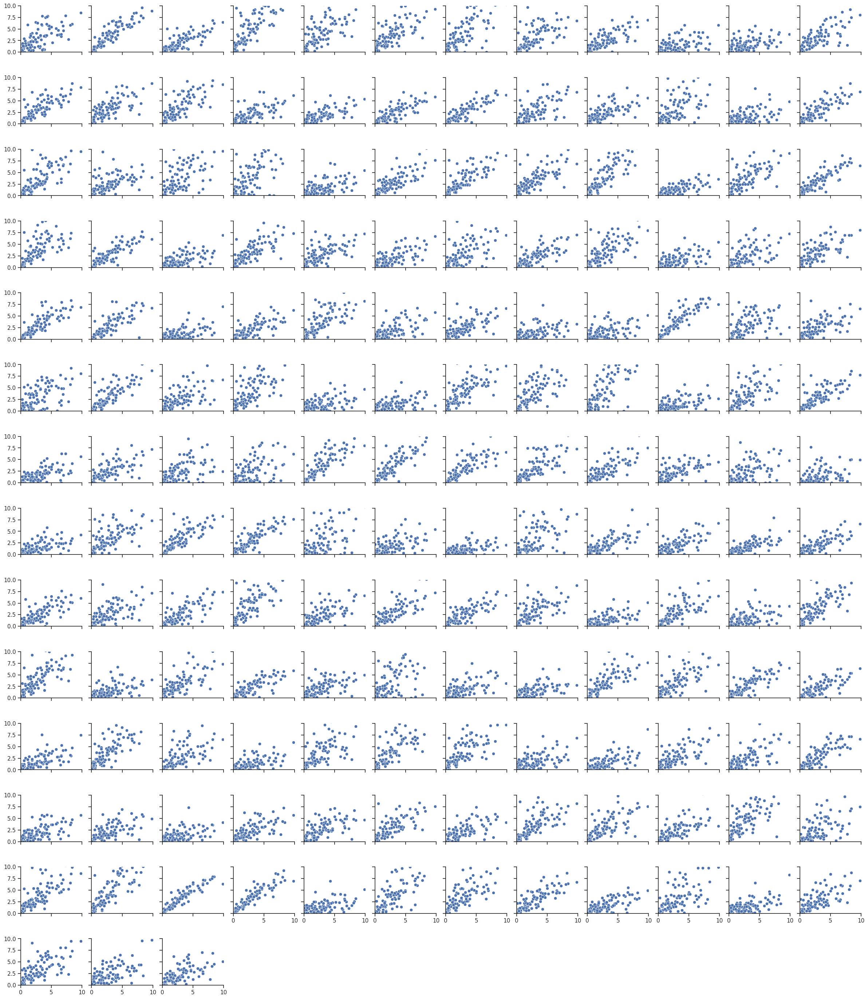

In [ ]:
sns.set(style="ticks")
g = sns.FacetGrid(sel_monthly_df.melt(id_vars=sel_monthly_df.columns[0]), col='variable', col_wrap=12, height=2)
g.map(sns.scatterplot, sel_monthly_df.columns[0], 'value', marker="o")
g.set_titles("")
g.set_axis_labels("", "")

plt.show()


## WIND SPEED

### CLEANING AND AGGREGATION

In [ ]:
from google.colab import files
up = files.upload()
import io
df_v  = pd.read_csv(io.BytesIO(up['Vento - Foglio1.csv']))

In [ ]:
df_v = df_v[l]

In [ ]:
for i, col1 in enumerate(df_v.columns):        # check presence of identical columns
    for col2 in df_v.columns[i+1:]:

        if (df_v[col1] == df_v[col2]).all():
            print(f"{col1} and {col2} are equal in DataFrame")
        else:
          continue

In [ ]:
for col in df_v.columns[1:]:                  # check if column has values that are not float
    if not isinstance(df_v[col], pd.Series):
        continue
    if not (df_v[col].apply(lambda x: isinstance(x, float) or np.isnan(x))).all():
        print(f"Column '{col}' contains non-float values.")

If the covariate's sequence has too many missing value in the period in which I am interest in for the MES estimation I have to delete all of its records.

In [ ]:
a = df_v.loc[8460:11476,:]   #period chosen for the MES (282:381)

In [ ]:
x = find_consecutive_minus_999(a)

In [ ]:
{key: [element for element in value if element > 6] for key, value in x.items()}

In [ ]:
del df_v['Corsico v.le Italia']
del df_v['Gambara v.Parma']
del df_v['Madesimo Spluga']
del df_v['Rho Scalo Fiorenza']
del df_v['Saronno v.Santuario']
del df_v['Vertemate con Minoprio serre']   #stations with too may NaN in the chosen interval

In [ ]:
modify_dataframe(df_v)

In [ ]:
df_v = df_v.replace(-999, np.nan)

In [ ]:
monthly_df_v = create_monthly_df(df_v)

In [ ]:
df_v = df_v / 10

In [ ]:
monthly_df_v = monthly_df_v.reset_index()

In [ ]:
monthly_df_v = monthly_df_v.loc[282:381,:]

In [ ]:
from google.colab import files
monthly_df_v.to_csv('vento_monthly_aggregate_282_381_72.csv', index=None, header=True)
files.download('vento_monthly_aggregate_282_381_72.csv')

### VISUAL ANALYSIS

**Trend over time of mointhly wind speed**

In [ ]:
# Generate a unique scatterplot with 160 different colors for each column
fig, ax = plt.subplots(figsize=(100, 100))
colors = list(mcolors.TABLEAU_COLORS.values())  # Get a list of distinct colors

for i, col in enumerate(c.columns):
    ax.scatter(c.index, c[col], color=colors[i % len(colors)], label=col)

ax.legend(ncol=20, loc='lower center', bbox_to_anchor=(0.5, -0.1))  # Add a legend showing the column names

plt.xlabel('Months')
plt.ylabel('Values')
plt.title('Scatterplot for each column')
plt.show()

**Relation between monthly average Rainfall and monthly average Wind Speed**

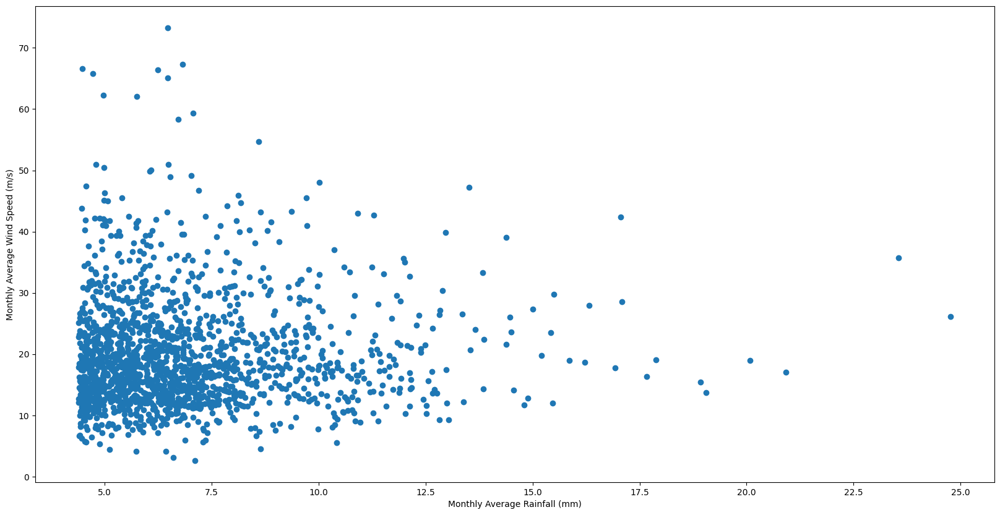

In [ ]:
df1 = sel_monthly_df[monthly_df_v.columns]
all_values_df1 = df1.values.flatten()
all_values_df2 = monthly_df_v.values.flatten()

# Filter data based on x-axis condition (x > 4.39)
filtered_values_df1 = all_values_df1[all_values_df1 > 4.39]
filtered_values_df2 = all_values_df2[all_values_df1 > 4.39]  # Use the same condition for filtering

# Create a scatterplot with filtered values
plt.figure(figsize=(20, 10))
plt.scatter(filtered_values_df1, filtered_values_df2)
plt.xlabel('Monthly Average Rainfall (mm)')
plt.ylabel('Monthly Average Wind Speed (m/s)')
#plt.title('temperatura')
plt.show()

## SOLAR RADIATION

### CLEANING AND AGGREGATION

In [ ]:
from google.colab import files
up = files.upload()
import io
df_r  = pd.read_csv(io.BytesIO(up['Radiazione Globale - Foglio1 (1).csv']))

In [ ]:
df_r = df_r[l]

In [ ]:
for i, col1 in enumerate(df_r.columns):
    for col2 in df_r.columns[i+1:]:
                                            # check if col1 and col2 are equal
        if (df_r[col1] == df_r[col2]).all():
            print(f"{col1} and {col2} are equal in DataFrame")
        else:
          continue

In [ ]:
for col in df_r.columns[1:]:
    if not isinstance(df_r[col], pd.Series):  # check if column is a pandas series
        continue
    if not (df_r[col].apply(lambda x: isinstance(x, float) or np.isnan(x))).all():
        print(f"Column '{col}' contains non-float values.")

In [ ]:
a = df_r.loc[8460:11476,:]   #period chosen for the MES (282:381)

In [ ]:
x = find_consecutive_minus_999(a)

In [ ]:
{key: [element for element in value if element > 6] for key, value in x.items()}

In [ ]:
del df_r['Bertonico v.Moro']
del df_r['Carona Carisole']
del df_r['Lanzada Passo Marinelli']
del df_r['Ponti sul Mincio v.San Martino']
del df_r['Saronno v.Santuario']   #stations with too may NaN in the chosen interval

In [ ]:
modify_dataframe(df_r)

In [ ]:
df_r = df_r.replace(-999, np.nan)

In [ ]:
monthly_df_r = create_monthly_df(df_r)

In [ ]:
monthly_df_r = monthly_df_r / 10

In [ ]:
monthly_df_r = monthly_df_r.reset_index()

In [ ]:
monthly_df_r = monthly_df_r.loc[282:381,:]

In [ ]:
from google.colab import files
monthly_df_r.to_csv('radiazione_monthly_aggregate_282_381_51.csv', index=None, header=True)
files.download('radiazione_monthly_aggregate_282_381_51.csv')

## VISUAL ANALYSIS

**Trend of monthly Radiation over years**

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Assuming you have a dataframe named 'df' with 160 columns

# Generate a unique scatterplot with 160 different colors for each column
fig, ax = plt.subplots(figsize=(100, 100))
colors = list(mcolors.TABLEAU_COLORS.values())  # Get a list of distinct colors

for i, col in enumerate(c.columns):
    ax.scatter(monthly_df_r.index, monthly_df_r[col], color=colors[i % len(colors)], label=col)

ax.legend(ncol=20, loc='lower center', bbox_to_anchor=(0.5, -0.1))  # Add a legend showing the column names

plt.xlabel('Months')
plt.ylabel('Values')
plt.title('Scatterplot for each column')
plt.show()

**Relation between Monthly Rainfall and Monthly Radiation**

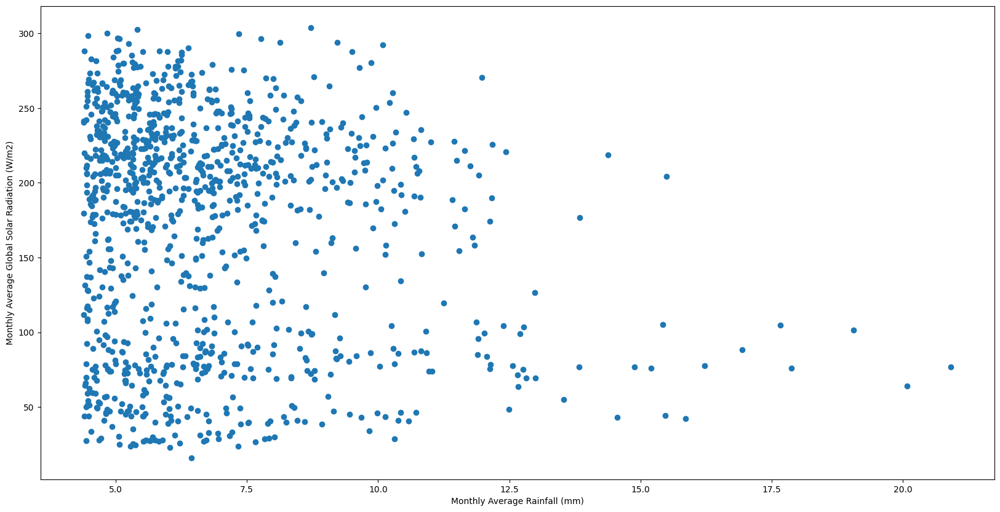

In [ ]:
df1 = sel_monthly_df[monthly_df_r.columns]
all_values_df1 = df1.values.flatten()
all_values_df2 = monthly_df_r.values.flatten()

# Filter data based on x-axis condition (x > 4.39)
filtered_values_df1 = all_values_df1[all_values_df1 > 4.39]
filtered_values_df2 = all_values_df2[all_values_df1 > 4.39]  # Use the same condition for filtering

# Create a scatterplot with filtered values
plt.figure(figsize=(20, 10))
plt.scatter(filtered_values_df1, filtered_values_df2)
plt.xlabel('Monthly Average Rainfall (mm)')
plt.ylabel('Monthly Average Global Solar Radiation (W/m2)')
#plt.title('temperatura')
plt.show()

##TEMPERATURE##

### DATA CLEANING AND AGGREGATION

In [ ]:
from google.colab import files
up = files.upload()
import io
df_t  = pd.read_csv(io.BytesIO(up['Temperatura - Foglio1.csv']))

Saving Radiazione Globale - Foglio1 (1).csv to Radiazione Globale - Foglio1 (1).csv


In [ ]:
df_t = df_t[l]

In [ ]:
for i, col1 in enumerate(df_t.columns):
    for col2 in df_t.columns[i+1:]:
                                            # check if col1 and col2 are equal
        if (df_t[col1] == df_t[col2]).all():
            print(f"{col1} and {col2} are equal in DataFrame")
        else:
          continue

In [ ]:
for col in df_t.columns[1:]:
    if not isinstance(df_t[col], pd.Series):  # check if column is a pandas series
        continue
    if not (df_t[col].apply(lambda x: isinstance(x, float) or np.isnan(x))).all():
        print(f"Column '{col}' contains non-float values.")

In [ ]:
a = df_t.loc[8460:11476,:]   #period chosen for the MES (282:381)

In [ ]:
x = find_consecutive_minus_999(a)

In [ ]:
{key: [element for element in value if element > 6] for key, value in x.items()}

In [ ]:
del df_t['Brescia v.Ziziola']
del df_t['Gambara v.Parma']
del df_t['Gordona']
del df_t['Livigno Passo Foscagno']
del df_t['Spinadesco v.Battisti']
del df_t['Bergamo v.Stezzano']  #stations with too may NaN in the chosen interval

In [ ]:
modify_dataframe(df_t)

In [ ]:
df_t = df_t.replace(-999, np.nan)

In [ ]:
monthly_df_t = create_monthly_df(df_t)

In [ ]:
monthly_df_t = monthly_df_t / 10

In [ ]:
monthly_df_t = monthly_df_t.reset_index()

In [ ]:
monthly_df_t = monthly_df_t.loc[282:381,:]

In [ ]:
from google.colab import files
monthly_df_t.to_csv('temperatura_monthly_aggregate_282_381_132.csv', index=None, header=True)
files.download('temperatura_monthly_aggregate_282_381_132.csv')

### VISUAL ANALYSIS

**Trend of monthly Temperature over years**

In [ ]:
# Generate a unique scatterplot with 160 different colors for each column
fig, ax = plt.subplots(figsize=(100, 100))
colors = list(mcolors.TABLEAU_COLORS.values())  # Get a list of distinct colors

for i, col in enumerate(monthly_df_t.columns):
    ax.scatter(monthly_df_t.index, monthly_df_t[col], color=colors[i % len(colors)], label=col)

ax.legend(ncol=20, loc='lower center', bbox_to_anchor=(0.5, -0.1))  # Add a legend showing the column names

plt.xlabel('Months')
plt.ylabel('Values')
plt.title('Scatterplot for each column')
plt.show()

**Relation between Monthly Rainfall and Monthly Temperature**

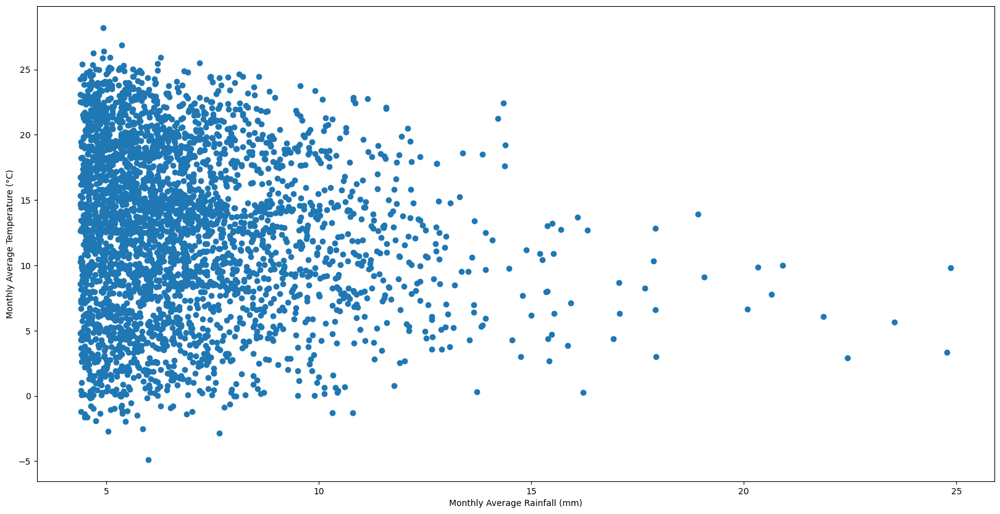

In [ ]:
df1 = monthly_df[monthly_df_t.columns]
all_values_df1 = df1.values.flatten()
all_values_df2 = monthly_df_t.values.flatten()

# Filter data based on x-axis condition (x > 4.39)
filtered_values_df1 = all_values_df1[all_values_df1 > 4.39]
filtered_values_df2 = all_values_df2[all_values_df1 > 4.39]  # Use the same condition for filtering

# Create a scatterplot with filtered values
plt.figure(figsize=(20, 10))
plt.scatter(filtered_values_df1, filtered_values_df2)
plt.xlabel('Monthly Average Rainfall (mm)')
plt.ylabel('Monthly Average Temperature (°C)')
#plt.title('temperatura')
plt.show()

## RELATIVE HUMIDITY

### DATA CLEANING AND AGGREGATION

In [ ]:
from google.colab import files
up = files.upload()
import io
df_u  = pd.read_csv(io.BytesIO(up['Umidità - Foglio1.csv']))

Saving Radiazione Globale - Foglio1 (1).csv to Radiazione Globale - Foglio1 (1).csv


In [ ]:
df_u = df_u[l]

In [ ]:
for i, col1 in enumerate(df_u.columns):
    for col2 in df_u.columns[i+1:]:
                                            # check if col1 and col2 are equal
        if (df_u[col1] == df_u[col2]).all():
            print(f"{col1} and {col2} are equal in DataFrame")
        else:
          continue

In [ ]:
for col in df_u.columns[1:]:
    if not isinstance(df_u[col], pd.Series):  # check if column is a pandas series
        continue
    if not (df_u[col].apply(lambda x: isinstance(x, float) or np.isnan(x))).all():
        print(f"Column '{col}' contains non-float values.")

In [ ]:
a = df_u.loc[8460:11476,:]   #period chosen for the MES (282:381)

In [ ]:
x = find_consecutive_minus_999(a)

In [ ]:
{key: [element for element in value if element > 6] for key, value in x.items()}

In [ ]:
del df_u['Bigarello']
del df_u['Caiolo']
del df_u['Fortunago']
del df_u['Gonzaga Palidano']
del df_u['Mantova Tridolino']
del df_u['Ponti sul Mincio v.San Martino']
del df_u['Valmadrera v.Pozzi']  #stations with too may NaN in the chosen interval

In [ ]:
modify_dataframe(df_u)

In [ ]:
df_u = df_u.replace(-999, np.nan)

In [ ]:
monthly_df_u = create_monthly_df(df_u)

In [ ]:
monthly_df_u = monthly_df_u / 10

In [ ]:
monthly_df_u = monthly_df_u.reset_index()

In [ ]:
monthly_df_u = monthly_df_u.loc[282:381,:]

In [ ]:
from google.colab import files
monthly_df_u.to_csv('umidità_monthly_aggregate_282_381_91.csv', index=None, header=True)
files.download('umidità_monthly_aggregate_282_381_91.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### VISUAL ANALYSIS

**Trend of Monthly Humidity over years**

In [ ]:
# Assuming you have a dataframe named 'df' with 160 columns

# Generate a unique scatterplot with 160 different colors for each column
fig, ax = plt.subplots(figsize=(100, 100))
colors = list(mcolors.TABLEAU_COLORS.values())  # Get a list of distinct colors

for i, col in enumerate(monthly_df_u.columns):
    ax.scatter(monthly_df_u.index, monthly_df_u[col], color=colors[i % len(colors)], label=col)

ax.legend(ncol=20, loc='lower center', bbox_to_anchor=(0.5, -0.1))  # Add a legend showing the column names

plt.xlabel('Months')
plt.ylabel('Values')
plt.title('Scatterplot for each column')
plt.show()

**Relation between Monthly Rainfall and Monthly Humidity**

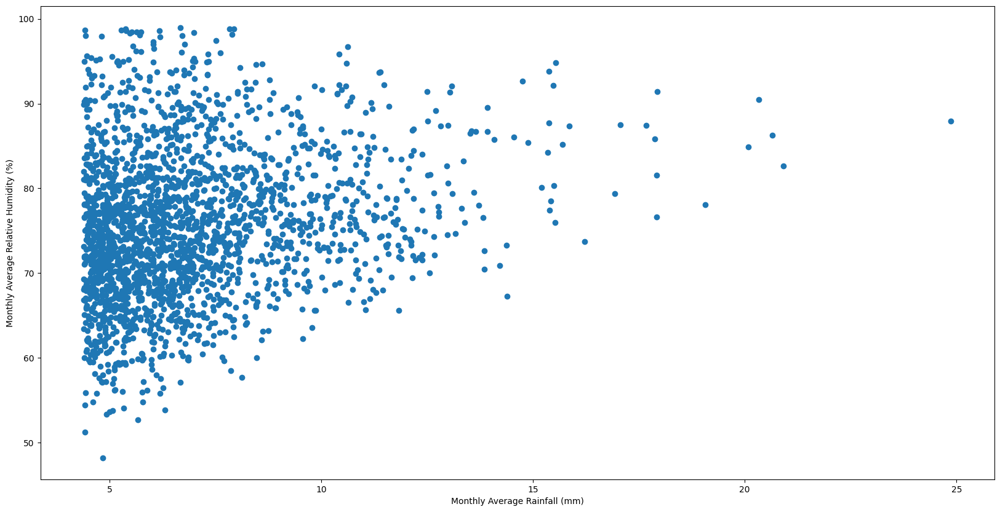

In [ ]:
df1 = sel_monthly_df[monthly_df_u.columns]
all_values_df1 = df1.values.flatten()
all_values_df2 = monthly_df_u.values.flatten()

# Filter data based on x-axis condition (x > 4.39)
filtered_values_df1 = all_values_df1[all_values_df1 > 4.39]
filtered_values_df2 = all_values_df2[all_values_df1 > 4.39]  # Use the same condition for filtering

# Create a scatterplot with filtered values
plt.figure(figsize=(20, 10))
plt.scatter(filtered_values_df1, filtered_values_df2)
plt.xlabel('Monthly Average Rainfall (mm)')
plt.ylabel('Monthly Average Relative Humidity (%)')
#plt.title('temperatura')
plt.show()

## SEASONS

I create the column "Season" that represent the corresponding month of the observation and from it the different dummies AutumnSpring, AutumnWinter, AutumnSummer and Autumn.
In the code the names are autunnoprim, autunnoinv, autunnoest and autunno that are the italian translations.

In [ ]:
pattern = [3, 3, 3, 4, 4, 4, 1, 1, 1, 2, 2, 2]  #3 autumn 4 winter 1 spring 2 summer

# Calculate the length of the pattern
pattern_length = len(pattern)

# Assign the pattern to the 'Season' column in a repeating manner
start_index = 0

sel_monthly_df['Season'].iloc[start_index:] = [pattern[i % pattern_length] for i in range(start_index, len(df))]

In [ ]:
def Autumn_Spring(stagione):
    if stagione in [2, 4]:
        return 0
    elif stagione in [1, 3]:
        return 1
    else:
        return None  # You can handle other cases if necessary

sel_monthly_df['autunno_prim'] = sel_monthly_df['Season'].apply(Autumn_Spring)

In [ ]:
def Autumn_Winter(stagione):
    if stagione in [1, 2]:
        return 0
    elif stagione in [3, 4]:
        return 1
    else:
        return None  # You can handle other cases if necessary

sel_monthly_df['autunno_inv'] = sel_monthly_df['Season'].apply(Autumn_Winter)

In [ ]:
def Autumn_Summer(stagione):
    if stagione in [1, 4]:
        return 0
    elif stagione in [3, 2]:
        return 1
    else:
        return None  # You can handle other cases if necessary

sel_monthly_df['autunno_est'] = sel_monthly_df['Season'].apply(Autumn_Summer)

In [ ]:
def Autumn(stagione):
    if stagione in [1,4,2] :
        return 0
    elif stagione in [3] :
        return 1
    else:
        return None  # You can handle other cases if necessary

# Use the apply function to create the "Piovosità" column based on the "Stagione" column
sel_monthly_df['autunno'] = sel_monthly_df['Seasons'].apply(Autumn)

In [ ]:
from google.colab import files
sel_monthly_df.to_csv('monthly_aggregate_282_381_160_seasons_dummy_eautunno.csv', index=None, header=True)
files.download('monthly_aggregate_282_381_160_seasons_dummy_eautunno.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# LOCATION DATASET PREPARATION

## 278 STATIONS

###DATA PREPARATION

The available data on the localization of the 278 weather stations is provided with the UTM system. As is quite complex, I convert the values to the usual latitude longitude system in degree decimals.

In [ ]:
%pip install utm

In [ ]:
pip install pyproj

In [ ]:
from google.colab import files
up = files.upload()
import io
loc  = pd.read_csv(io.BytesIO(up['locations.tsv']), sep='\t')

loc.head(10)

In [ ]:
loc = loc[['idStazione', 'Stazione', 'Provincia','UTM_Nord', 'UTM_EST','latitude', 'longitude']]

In [ ]:
loc['UTM_Nord'] = loc['UTM_Nord'].astype(float)
loc['UTM_EST'] = loc['UTM_EST'].astype(float)


In [ ]:
import utm
def converter(v1, v2):
# Define the UTM coordinates
  utm_easting = v2  # Example UTM easting
  utm_northing = v1   # Example UTM northing
  utm_zone_number = 32  # Example UTM zone number (North Italy)
  utm_zone_letter = 'T'  # Example UTM zone letter (North Italy)


  #convert from UTM to latitude and longitude measured in decimal of degree
  lat, lon = utm.to_latlon(utm_easting, utm_northing, utm_zone_number, utm_zone_letter)
  return lat, lon

# Apply the converter function to create 'latitude' and 'longitude' columns
loc[['latitude', 'longitude']] = loc[['UTM_Nord', 'UTM_EST']].apply(lambda row: pd.Series(converter(row['UTM_Nord'], row['UTM_EST'])), axis=1)

### DATA VISUALIZATION
I create a map that shows the distibution of the 278 weather stations around Lombardy (Italy)

In [ ]:
import folium  #278

# create a map with the 278 stations
m = folium.Map(location=[loc.at[1, "latitude"],loc.at[1, "longitude"]], zoom_start=12)

# add markers to the map
for i in range(1,len(loc)):
  try:
    folium.Marker(location=[loc.at[i, "latitude"],loc.at[i, "longitude"]], popup=loc.at[i, "0"]).add_to(m)
  except:
    print(i)

In [ ]:
m

## 160 STATIONS

### DATA PREPARATIONS

In [ ]:
low_l =  [i.lower() for i in l]

In [ ]:
filtered_pos = pos[pos['Stazione'].isin(low_l)]

In [ ]:
from google.colab import files
filtered_pos.to_csv('location_282_381_160.csv', index=None, header=True)
files.download('location_282_381_160.csv')

### DATA VISUALIZATION
I create a map that shows the distibution of the 160 weather stations chosen for the MES estimation around Lombardy (Italy)

In [ ]:
import folium  #160

# create a map with the 160 stations
m = folium.Map(location=[filtered_pos.at[1, "latitude"],filtered_pos.at[1, "longitude"]], zoom_start=12)

# add markers to the map
for i in range(1,len(filtered_pos)):
  try:
    folium.Marker(location=[filtered_pos.at[i, "latitude"],filtered_pos.at[i, "longitude"]], popup=filtered_pos.at[i, "0"]).add_to(m)
  except:
    print(i)

In [ ]:
m

# ANALYSIS OF EV index REGRESSION COEFFICIENTS

After the estimation of the EV index using covariates I choose for each station the best covariate and its best level. "best" means that it lead to the highest estimate of the EV index within the interval from -0.5 to 0.5. Then, since the maximization of the likelihood provide the regression coefficents estimates and not directly the EV estimate I store the data to analyze them.
Firstly, I would like to see which values do they take and if their interpretation is alligned with theory. Secondly, I would like to check if the relation between rainfall and the coovariate is correctly reflected in the coefficient estimate.  Moreover, I would like to see whether they have an interesting spatial distribution.


In [ ]:
from google.colab import files
up = files.upload()
import io
coov  = pd.read_csv(io.BytesIO(up['coovariate_choice.csv']))

In [ ]:
from google.colab import files
up = files.upload()
import io
coef  = pd.read_csv(io.BytesIO(up['coef_choosen160.csv']))

### ANALYSIS OF THE COEFFICIENTS OF THE COOVARIATES

In [ ]:
coef[coef[1] == 'temp'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'umid'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'rad'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'vento'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'autunno_est'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'autunno_inv'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'autunno_prim'].sort_values(by=2, ascending=True)

In [ ]:
coef[coef[1] == 'autunno'].sort_values(by=2, ascending=True)

**Relation between Covariates and Extreme Rainfall in the raw data compared to the regression slope coefficient**

The Rainfall is considered as extreme when it is over 4.39 mm per month. However, in some sites it may be not the case. Therefore these plots are just to get an overall idea.

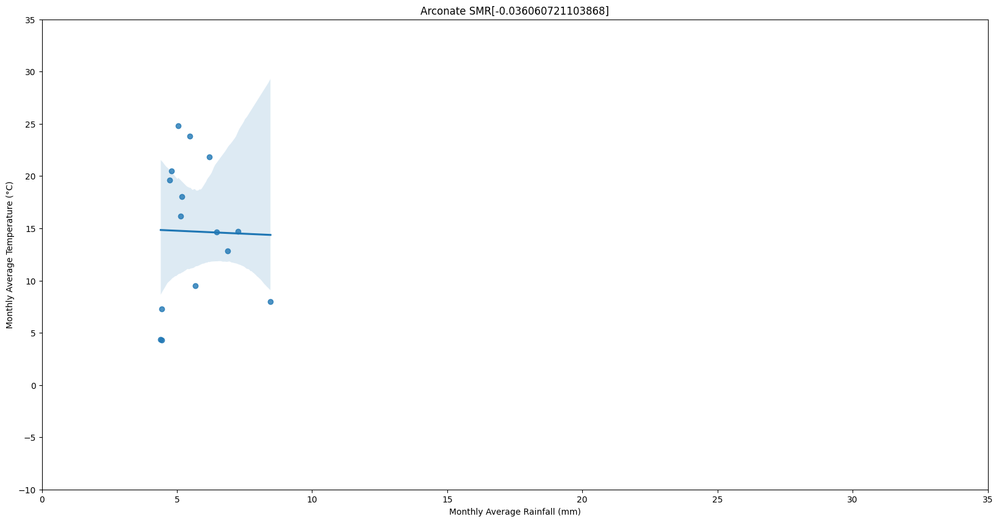

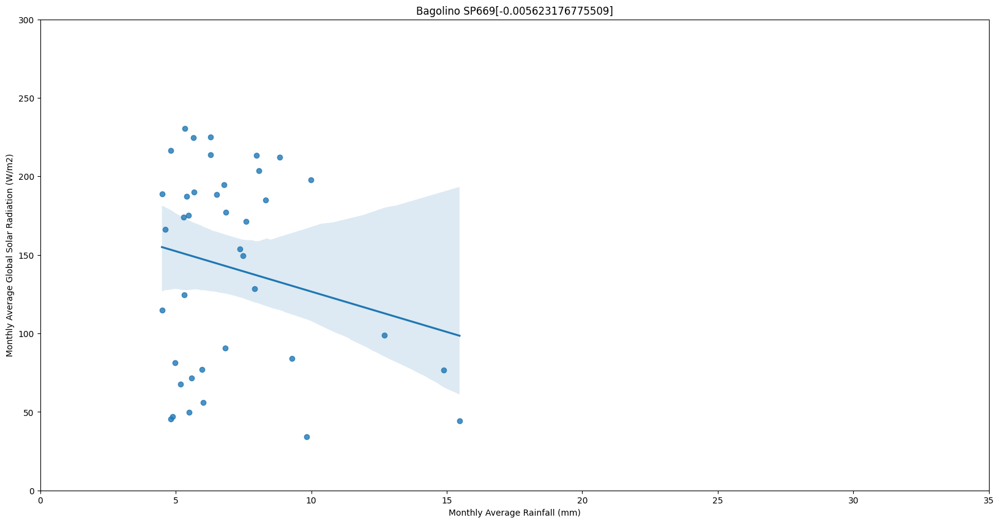

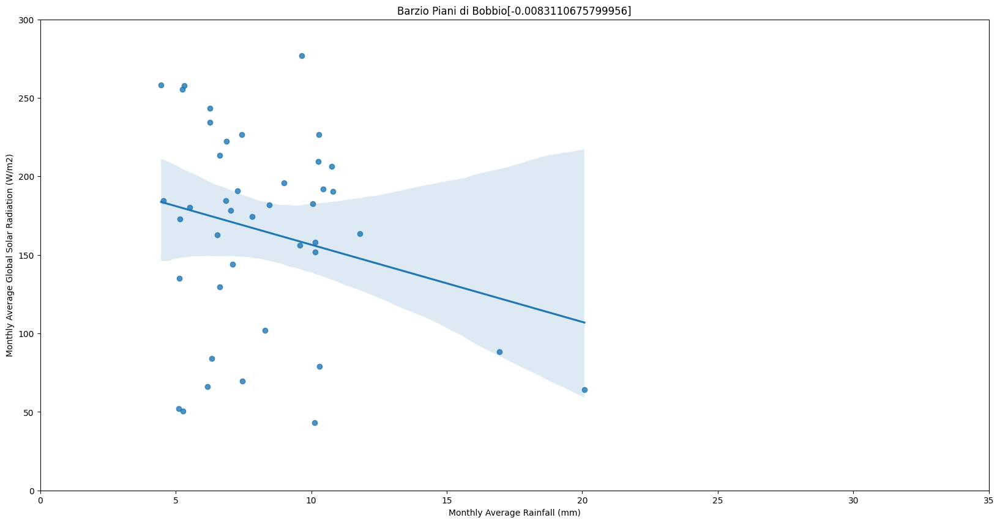

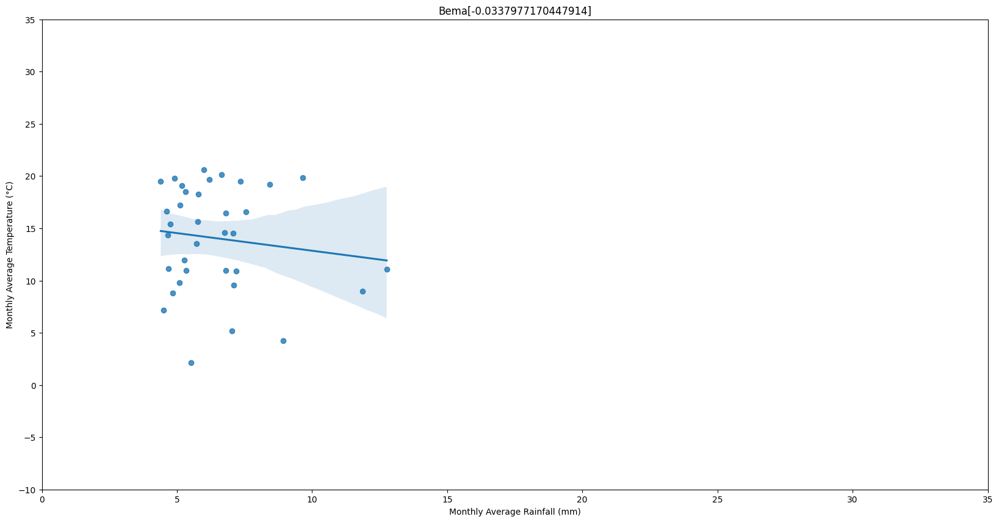

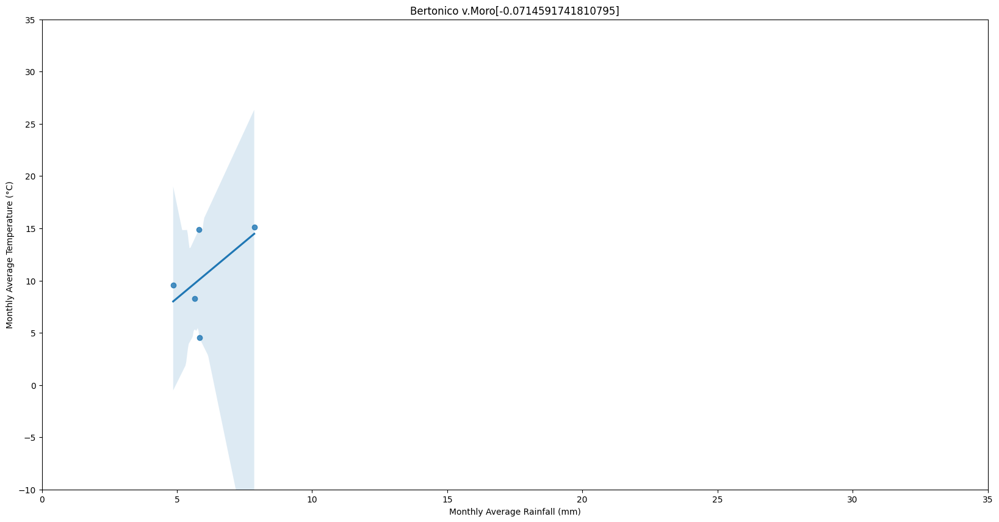

...

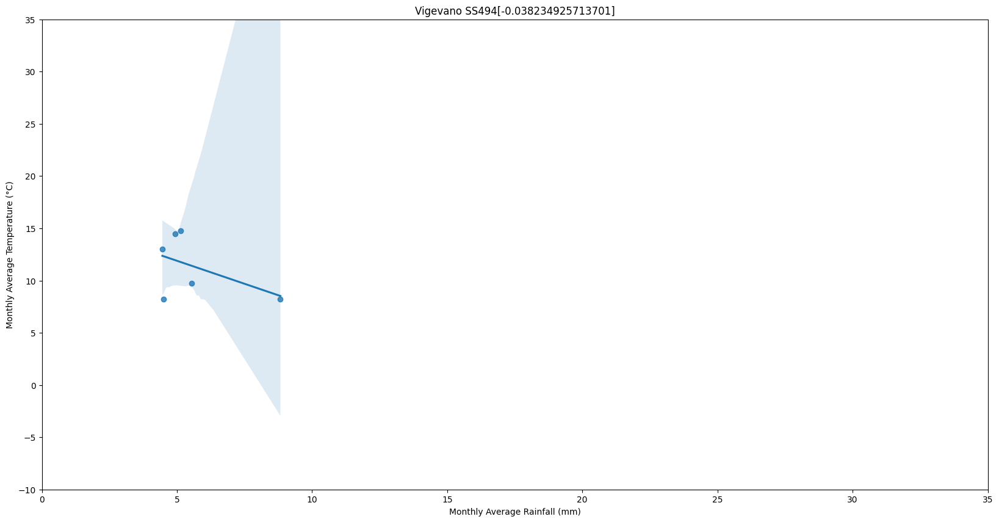

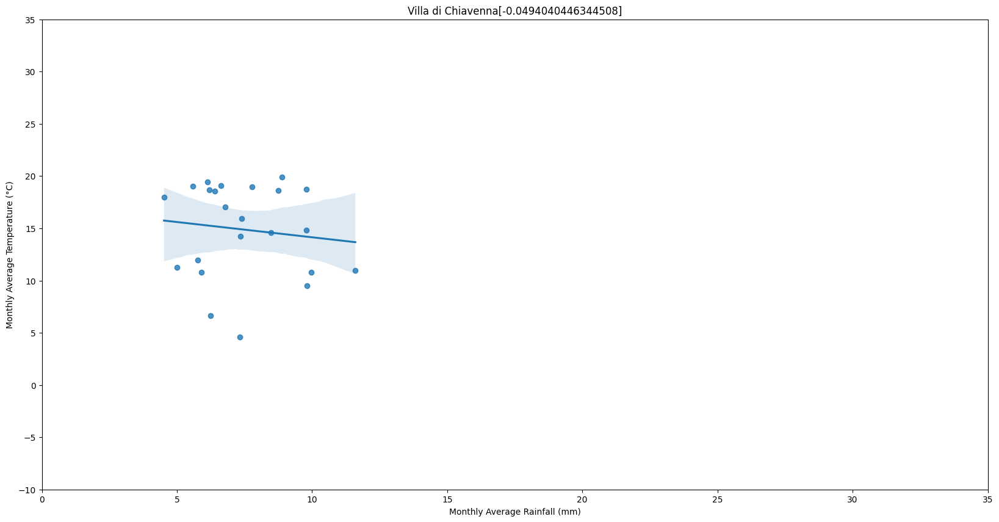

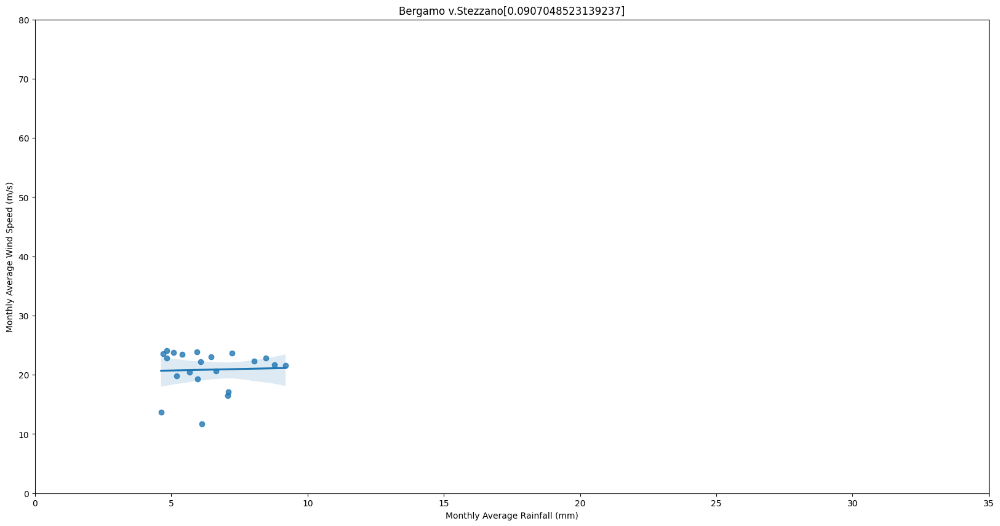

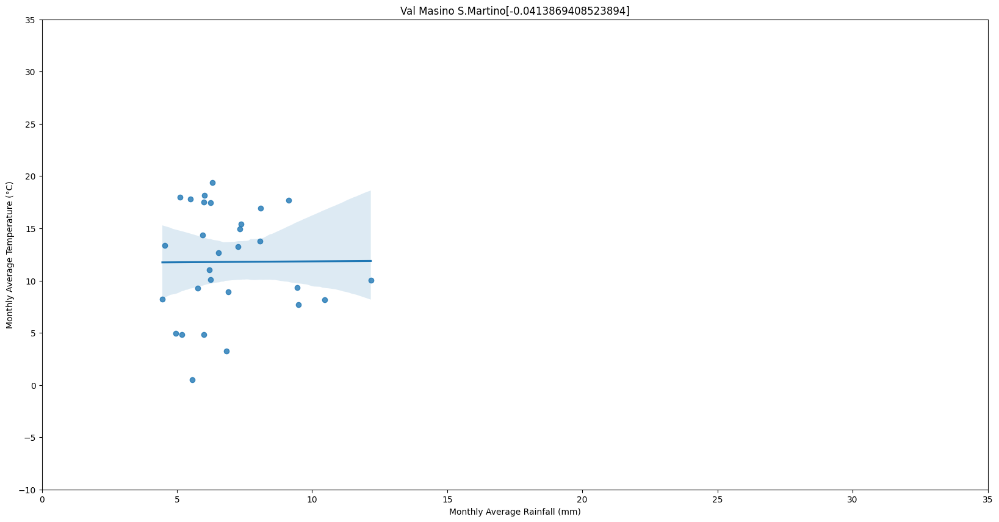

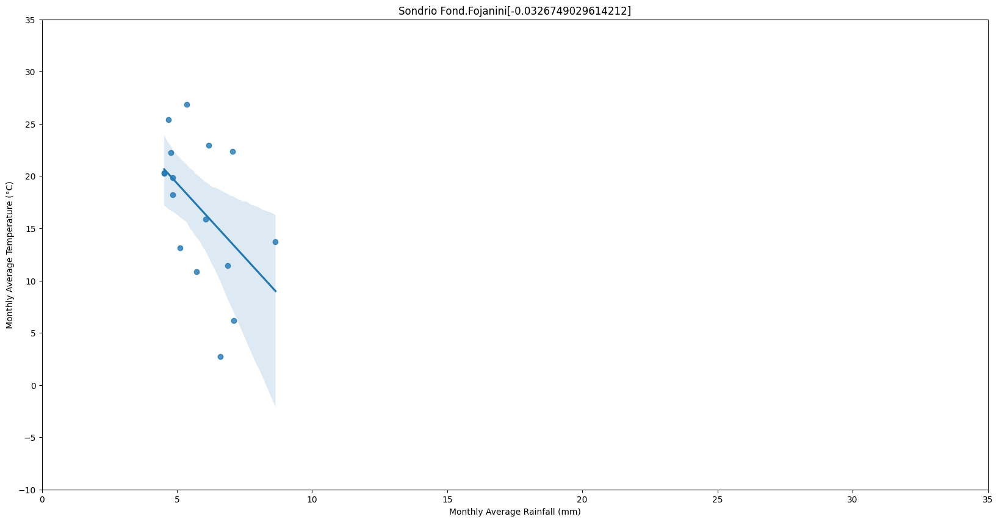

In [ ]:
for i in range(0,160):
  if coov.iloc[i,5]==1 or  coov.iloc[i,6]==1 or  coov.iloc[i,7]==1 or  coov.iloc[i,8]==1 or  coov.iloc[i,9]==1 or coov.iloc[i,10]==1:
    column = sel_monthly_df.columns[i]
    plt.figure(figsize=(20, 10))
    #sns.set(style="whitegrid")  # Set the style of the plot
    all_values_df1 = sel_monthly_df[column].values.flatten()
    sns.regplot(x= sel_monthly_df[column][all_values_df1 > 4.39], y = monthly_df_t[column][all_values_df1 > 4.39], fit_reg = True)
    plt.xlabel('Monthly Average Rainfall (mm)')
    plt.ylabel('Monthly Average Temperature (°C)')
    plt.title(column + str(coef.iloc[i,3:4].values))
    plt.xlim(0, 35)
    plt.ylim(-10, 35)
    plt.show()
  elif coov.iloc[i,11]==1 or  coov.iloc[i,12]==1 or  coov.iloc[i,13]==1 or  coov.iloc[i,14]==1:
    column = sel_monthly_df.columns[i]
    plt.figure(figsize=(20, 10))
    all_values_df1 = sel_monthly_df[column].values.flatten()
    sns.regplot(x= sel_monthly_df[column][all_values_df1 > 4.39], y = monthly_df_v[column][all_values_df1 > 4.39], fit_reg = True)
    plt.xlabel('Monthly Average Rainfall (mm)')
    plt.ylabel('Monthly Average Wind Speed (m/s)')
    plt.title(column + str(coef.iloc[i,3:4].values))
    plt.xlim(0, 35)
    plt.ylim(0, 80)
    plt.show()
  elif coov.iloc[i,15]==1 or  coov.iloc[i,16]==1:
    column = sel_monthly_df.columns[i]
    plt.figure(figsize=(20, 10))
    all_values_df1 = sel_monthly_df[column].values.flatten()
    sns.regplot(x= sel_monthly_df[column][all_values_df1 > 4.39], y = monthly_df_r[column][all_values_df1 > 4.39], fit_reg = True)
    plt.xlabel('Monthly Average Rainfall (mm)')
    plt.ylabel('Monthly Average Global Solar Radiation (W/m2)')
    plt.title(column + str(coef.iloc[i,3:4].values))
    plt.xlim(0, 35)
    plt.ylim(0, 300)
    plt.show()
  elif coov.iloc[i,16]==1 or  coov.iloc[i,17]==1 or coov.iloc[i,18]==1 or  coov.iloc[i,19]==1:
    column = sel_monthly_df.columns[i]
    plt.figure(figsize=(20, 10))
    all_values_df1 = sel_monthly_df[column].values.flatten()
    sns.regplot(x= sel_monthly_df[column][all_values_df1 > 4.39], y = monthly_df_u[column][all_values_df1 > 4.39], fit_reg = True)
    plt.xlabel('Monthly Average Rainfall (mm)')
    plt.ylabel('Monthly Average Relative Humidity (%)')
    plt.title(column + str(coef.iloc[i,3:4].values))
    plt.xlim(0, 35)
    plt.ylim(0, 100)
    plt.show()
  else:
    continue

### SPATIAL DISTRIBUTION OF THE COVARIATE

In [ ]:
import folium
import numpy as np
# Assuming you have a DataFrame named 'df' with columns 'latitude', 'longitude', and '0'

# create a map centered on a specific location
m = folium.Map(location=[loc.at[0, "latitude"], loc.at[0, "longitude"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,160) :
  #a = np.isnan(merged.at[i,1])
 #if a == True
  if merged.at[i,1] == "aut_est" or merged.at[i,1] == "aut_inv" or merged.at[i,1] == "aut_prim" or merged.at[i,1] == "aut":
    marker_color = 'green'  # Set the marker color based on your condition
  elif merged.at[i,1] == 'temp':
     marker_color = 'blue'
  elif merged.at[i,1] == "vento":
    marker_color = 'orange'  # Set a different color if the condition is not met
  elif merged.at[i,1] == "umid":
    marker_color = 'pink'
  elif merged.at[i,1] == "rad":
    marker_color = 'red'
  else:
    continue

        # Create a custom icon for the marker with the specified color
  icon = folium.Icon(color=marker_color)

  folium.Marker(location=[loc.at[i, "latitude"], loc.at[i, "longitude"]], popup=merged.iloc[i,2:4], icon=icon ).add_to(m)
    #except:
       # print(i)

# Display the map
m

#  SPATIAL ANALYSIS OF THE MES ESTIMATES
I analyze the empirical distribution of the estimated MES and then their spatial distribution around the region of Lombardy (Italy)

## MES calculated with Hill Estimator - First approach

###Empirical Distribution

In [ ]:
from google.colab import files
up = files.upload()
import io
MES_H_1  = pd.read_csv(io.BytesIO(up['MES_Hill1_weighted.csv']))

In [ ]:
plt.hist(MES_H_1, bins=20, edgecolor='black')  #empirical distribution of MES
plt.show()

###Spatial Distribution

In [ ]:
import folium

# create map of 160 stations with different colors based on value of the MES

# create a map centered on a specific location
m = folium.Map(location=[filtered_loc.at[0, "latitude"], filtered_loc.at[0, "longitude"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,160):
    try:
        if MES_H_1[i]<15 :
            marker_color = 'green'  # Set the marker color based on your condition
        elif MES_H_1[i]<25:
            marker_color = 'orange'  # Set a different color if the condition is not met
        else:
            marker_color = 'red'

        # Create a custom icon for the marker with the specified color
        icon = folium.Icon(color=marker_color)

        folium.Marker(
            location=[filtered_loc.at[i, "latitude"], filtered_loc.at[i, "longitude"]],
            popup= filtered_loc.at[i, "0"],
            icon=icon ).add_to(m)
    except:
        print(i)

# Display the map
m

## MES calculated with Hill Estimator - Second approach

###Empirical Distribution

In [ ]:
from google.colab import files
up = files.upload()
import io
MES_H_2  = pd.read_csv(io.BytesIO(up['MES_Hill2_weighted.csv']))

In [ ]:
plt.hist(MES_H_2, bins=20, edgecolor='black')  #empirical distribution of MES
plt.show()

###Spatial Distribution

In [ ]:
import folium

# create map of 160 stations with different colors based on value of the MES

# create a map centered on a specific location
m = folium.Map(location=[filtered_loc.at[0, "latitude"], filtered_loc.at[0, "longitude"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,125):
    try:
        if MES_H_2[i]<15 :
            marker_color = 'green'  # Set the marker color based on your condition
        elif MES_H_2[i]<25:
            marker_color = 'orange'  # Set a different color if the condition is not met
        else:
            marker_color = 'red'

        # Create a custom icon for the marker with the specified color
        icon = folium.Icon(color=marker_color)

        folium.Marker(
            location=[filtered_loc.at[i, "latitude"], filtered_loc.at[i, "longitude"]],
            popup= filtered_loc.at[i, "0"],
            icon=icon ).add_to(m)
    except:
        print(i)

# Display the map
m

## MES calculated with coovariate introduction - First approach

###Empirical Distribution

In [ ]:
from google.colab import files
up = files.upload()
import io
MES_C_1  = pd.read_csv(io.BytesIO(up['MES_Covl_weighted.csv']))

In [ ]:
plt.hist(MES_C_1, bins=20, edgecolor='black')  #empirical distribution of MES
plt.show()

###Spatial Distribution

In [ ]:
import folium

# create map of 160 stations with different colors based on value of the MES

# create a map centered on a specific location
m = folium.Map(location=[filtered_loc_125.at[0, "latitude"], filtered_loc_125.at[0, "longitude"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,125):
    try:
        if MES_C_1[i]<15 :
            marker_color = 'green'  # Set the marker color based on your condition
        elif MES_C_1[i]<25:
            marker_color = 'orange'  # Set a different color if the condition is not met
        else:
            marker_color = 'red'

        # Create a custom icon for the marker with the specified color
        icon = folium.Icon(color=marker_color)

        folium.Marker(
            location=[filtered_loc_125.at[i, "latitude"], filtered_loc_125.at[i, "longitude"]],
            popup= filtered_loc_125.at[i, "0"],
            icon=icon).add_to(m)
    except:
        print(i)

# Display the map
m

## MES calculated with coovariate introduction - Second approach

###Empirical Distribution

In [ ]:
from google.colab import files
up = files.upload()
import io
MES_C_2  = pd.read_csv(io.BytesIO(up['MES_Cov2_weighted.csv']))

In [ ]:
plt.hist(MES_C_2, bins=20, edgecolor='black')  #empirical distribution of MES
plt.show()

In [ ]:
import folium

# create map of 160 stations with different colors based on value of the MES

# create a map centered on a specific location
m = folium.Map(location=[filtered_loc_125.at[0, "latitude"], filtered_loc_125.at[0, "longitude"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,125):
    try:
        if MES_C_2[i]<15 :
            marker_color = 'green'  # Set the marker color based on your condition
        elif MES_C_2[i]<25:
            marker_color = 'orange'  # Set a different color if the condition is not met
        else:
            marker_color = 'red'

        # Create a custom icon for the marker with the specified color
        icon = folium.Icon(color=marker_color)

        folium.Marker(
            location=[filtered_loc_125.at[i, "latitude"], filtered_loc_125.at[i, "longitude"]],
            popup= filtered_loc_125.at[i, "0"],
            icon=icon).add_to(m)
    except:
        print(i)

# Display the map
m

# WEIGHTS DERIVATION
For the weighted estimation of the MES I fit a model of the spatial correlation between each pair of weather stations. However, after the fitting the weights calculation requires the distance between each pair of sites. These distances are calculated here. Moreover, the empirical correlation between the stations is plotted to have a comparison for the estimated model.

## DISTANCE DERIVATION - 160 STATIONS

In [ ]:
!pip install haversine

In [ ]:
import haversine as hs
from haversine import Unit

In [ ]:
data = np.empty((160,  160))
data[:] = np.nan

dist = pd.DataFrame(data)

In [ ]:
for i in range(0,160):      #pairwise distance between the 160 distance
  for j in range(0,160):
      loc1 = (df.at[i,"latitude"],df.at[i,"longitude"])
      loc2 = (df.at[j,"latitude"],df.at[j,"longitude"])
      dist.at[j,i] = hs.haversine(loc1,loc2,unit=Unit.KILOMETERS)

In [ ]:
from google.colab import files
dist.to_csv('dist_159_R.csv', index=None, header=True)
files.download('dist_159_R.csv')

## SCALED RAINFALL DATA
The correlation model requires the data to be Gaussian distributed. Therefore, we scaled them to have mean 0 and variance 1.

In [ ]:
import sklearn
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled = scaler.fit_transform(sel_monthly_df)
scaled = pd.DataFrame(scaled, columns=list(sel_monthly_df.columns))

## CORRELATION PLOT

In [ ]:
corr_matrix = sel_monthly_df.corr()

In [ ]:
x = dist.iloc[:,1:].values.flatten()
y = corr_matrix.iloc[:,:].values.flatten()


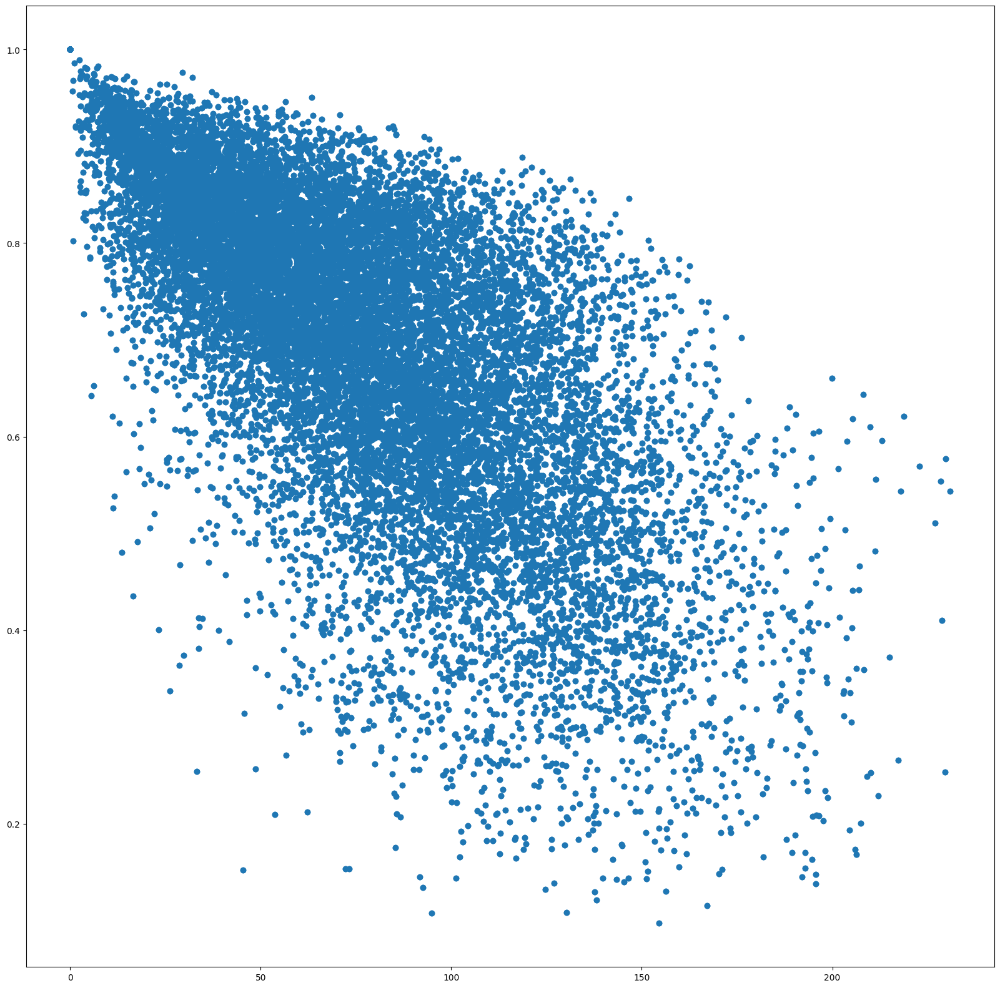

In [ ]:
fig = plt.figure(figsize=(20, 20))
plt.scatter(x, y)
plt.show()

# DATA PREPARATION AND CLEANING - 29 NEW STATIONS
For testing the goodness of fit of the prediction model through kriging I look for a new sample of stations for a period of 100 months so to use all the 160 stations as training sample.

## MONTHLY RAINFALL DATA PREPARATION

In [ ]:
rem_monthly_df = monthly_df.drop(columns =lim_l)

In [ ]:
find_complete_sequence(rem_monthly_df.iloc[:,1:], 100)

In [ ]:
l2 = [ 'Agrate Brianza v.Ferrario',
'Asola Sorbara',
'Bagolino Valle Dorizzo',
'Barni',
'Bienno',
'Bormio v.Monte Braulio',
'Busto Arsizio v.Magenta',
'Carate Brianza v.De Gasperi',
'Castiglione delle Stiviere',
"Chiesa in Valmalenco Alpe dell' Oro",
'Clusone Campo Sportivo',
'Crema v.Camporelle',
'Crema v.XI febbraio',
'Darfo Boario Terme',
'Darfo Boario Terme SS 42',
'Gera Lario Fuentes',
'Lomello SS 211',
'Lonate Pozzolo v.Veneto',
'Mariano Comense v.le Lombardia',
'Molteno Cimitero',
'Morbegno v.Cortivacci',
'Nibionno v.della Chiesa',
'San Pellegrino Terme P.za Alighieri',
'Sermide e Felonica SP 91',
'Somma Lombardo v.Facchinetti',
'Sondrio v.Mazzini',
'Tavazzano con Villavesco Enel suolo',
'Varese v.Vidoletti',
'Varzi v.Mazzini'
]

In [ ]:
rem_monthly_df = rem_monthly_df[l2]
rem_monthly_df = rem_monthly_df.iloc[154:254,1:]

In [ ]:
from google.colab import files
rem_monthly_df.to_csv('new_stations_29.csv', index=None, header=True)
files.download('new_stations_29.csv')

## COVARIANCE DATA PREPARATION

### HUMIDITY, TEMPERATURE, SOLAR RADIATION, WIND SPEED

In [ ]:
from google.colab import files
up = files.upload()
import io
df_u2  = pd.read_csv(io.BytesIO(up['COOV29 - UMIDITA.csv'])) #humidity

In [ ]:
from google.colab import files
up = files.upload()
import io
df_t2  = pd.read_csv(io.BytesIO(up['COOV29 - TEMPERATURA.csv'])) #temperature

In [ ]:
from google.colab import files
up = files.upload()
import io
df_r2  = pd.read_csv(io.BytesIO(up['COOV29 - RADIAZIONE.csv']))  #solar radiation

In [ ]:
from google.colab import files
up = files.upload()
import io
df_v2  = pd.read_csv(io.BytesIO(up['COOV29 - VENTO.csv']))  #wind speed

In [ ]:
df_u2 = df_u2[l2]  #humidty
df_t2 = df_t2[l2]  #temperature
df_r2 = df_r2[l2]  #solar radiation
df_v2 = df_v2[l2]  #wind speed

In [ ]:
modify_dataframe(df_u2)
modify_dataframe(df_t2)
modify_dataframe(df_r2)
modify_dataframe(df_v2)

In [ ]:
df_u2 = df_u2.replace(-999, np.nan)
df_t2 = df_t2.replace(-999, np.nan)
df_r2 = df_r2.replace(-999, np.nan)
df_v2 = df_v2.replace(-999, np.nan)

Monthly Aggregation

In [ ]:
monthly_df_u2 = create_monthly_df_u2(df_u2)
monthly_df_t2 = create_monthly_df_t2(df_t2)
monthly_df_r2 = create_monthly_df_r2(df_r2)
monthly_df_v2 = create_monthly_df_v2(df_v2)


In [ ]:
monthly_df_u2 =  monthly_df_u2/10
monthly_df_t2 = monthly_df_t2/10
monthly_df_r2 = monthly_df_r2/10
monthly_df_v2 = monthly_df_v2/10

In [ ]:
monthly_df_u2 = monthly_df_u2.reset_index()
monthly_df_t2 = monthly_df_t2.reset_index()
monthly_df_r2 = monthly_df_r2.reset_index()
monthly_df_v2 = monthly_df_v2.reset_index()

In [ ]:
monthly_df_u2 = monthly_df_u2.iloc[154:254,:]
monthly_df_t2 = monthly_df_t2.iloc[154:254,:]
monthly_df_r2 = monthly_df_r2.iloc[154:254,:]
monthly_df_v2 = monthly_df_v2.iloc[154:254,:]

In [ ]:
from google.colab import files
monthly_df_u2.to_csv('new_stations_29_umid.csv', index=None, header=True)
files.download('new_stations_29_umid.csv')

In [ ]:
from google.colab import files
monthly_df_t2.to_csv('new_stations_29_temp.csv', index=None, header=True)
files.download('new_stations_29_rad.csv')

In [ ]:
from google.colab import files
monthly_df_r2.to_csv('new_stations_29_rad.csv', index=None, header=True)
files.download('new_stations_29_rad.csv')

In [ ]:
from google.colab import files
monthly_df_v2.to_csv('new_stations_29_vento.csv', index=None, header=True)
files.download('new_stations_29_vento.csv')

### SEASONS

In [ ]:
pattern = [2, 3, 3, 3, 4, 4, 4, 1, 1, 1, 2,2] #3 autunno

# Calculate the length of the pattern
pattern_length = len(pattern)

start_index = 0

rem_monthly_df['Season'].iloc[start_index:] = [pattern[i % pattern_length] for i in range(start_index, len(rem_monthly_df))]

In [ ]:
rem_monthly_df['Autumn_Spring'] = rem_monthly_df['Season'].apply(Autumn_Spring)

In [ ]:
rem_monthly_df['Autumn_Winter'] = rem_monthly_df['Season'].apply(Autumn_Winter)

In [ ]:
rem_monthly_df['Autumn_Summer'] = rem_monthly_df['Season'].apply(Autumn_Summer)

In [ ]:
rem_monthly_df['Autumn'] = rem_monthly_df['Season'].apply(Autumn)

In [ ]:
from google.colab import files
rem_monthly_df.to_csv('new_stations_29_seasons.csv', index=None, header=True)
files.download('new_stations_29_seasons.csv')

## LOCATION DATA OF THE STATIONS PREPARATION

In [ ]:
low_l2 =  [i.lower() for i in l2]

In [ ]:
filtered_pos2 = pos[pos['Stazione'].isin(low_l2)]

In [ ]:
import folium  #29

# create a map with the 29 stations
m = folium.Map(location=[filtered_pos2.at[1, "latitude"],filtered_pos2.at[1, "longitude"]], zoom_start=12)

# add markers to the map
for i in range(1,len(filtered_pos2)):
  try:
    folium.Marker(location=[filtered_pos2.at[i, "latitude"],filtered_pos2.at[i, "longitude"]], popup=filtered_pos2.at[i, "0"]).add_to(m)
  except:
    print(i)

In [ ]:
from google.colab import files
filtered_pos2.to_csv('loc_new_stations_29.csv', index=None, header=True)
files.download('loc_new_stations_29.csv')

## DISTANCE DATA PREPARATION

In [ ]:
data = np.empty((28, 29))
data[:] = np.nan

dist2 = pd.DataFrame(data)

In [ ]:
for i in range(0,29):
  z = 0
  for j in range(0,29):
    if i != j:
      loc1 = (df.at[i,"latitude"],df.at[i,"longitude"])
      loc2 = (df.at[j,"latitude"],df.at[j,"longitude"])
      dist2.at[z,i] = hs.haversine(loc1,loc2,unit=Unit.KILOMETERS)
      z += 1


In [ ]:
from google.colab import files
dist2.to_csv('dist_29.csv', index=None, header=True)
files.download('dist_29.csv')

# PREDICTION OF KRIGING FOR SQUARE AREA AROUND LOMBARDY

## DATA PREPARATION


In [ ]:
min(loc["latitude"]), max(loc["latitude"]), min(loc["longitude"]), max(loc["longitude"])

(44.6837785, 46.49442681, 8.573921779, 10.88713683)

In [ ]:
lat_range = np.arange(44.68, 46.49, 0.1)
long_range = np.arange(8.57, 10.88, 0.1)

# Create lists for latitudes and longitudes
lat = []
long = []

# Populate the lists using nested loops
for i in lat_range:
    for j in long_range:
        lat.append(i)
        long.append(j)

In [ ]:
from google.colab import files
up = files.upload()
import io
pred  = pd.read_csv(io.BytesIO(up['kriging1.csv']))

In [ ]:
import folium

# Assuming you have a DataFrame named 'df' with columns 'latitude', 'longitude', and '0'

# create a map centered on a specific location
m = folium.Map(location=[pred.at[1, "V1"], pred.at[0, "V1"]], zoom_start=12, tiles='Stamen Terrain')

# add markers to the map
for i in range(0,456):
    try:
        if pred.iloc[2, i]<12 :
            marker_color = 'green'  # Set the marker color based on your condition
        elif pred.iloc[2, i]<20:
            marker_color = 'orange'  # Set a different color if the condition is not met
        else:
            marker_color = 'red'

        # Create a custom icon for the marker with the specified color
        icon = folium.Icon(color=marker_color)

        folium.Marker(
            location=[pred.iloc[1, i], pred.iloc[0, i]],
            popup=i,
            icon=icon
        ).add_to(m)
    except:
        print(i)

# Display the map
m